In [9]:
!pip install kagglehub -q

import kagglehub, shutil, os

# Download dataset
path = kagglehub.dataset_download("suchintikasarkar/sentiment-analysis-for-mental-health")
print("Original download path:", path)

# Copy it to visible content folder
dest = "/content/mental_health_dataset"
shutil.copytree(path, dest, dirs_exist_ok=True)
print("Dataset copied to:", dest)

# List files
!ls /content/mental_health_dataset


Using Colab cache for faster access to the 'sentiment-analysis-for-mental-health' dataset.
Original download path: /kaggle/input/sentiment-analysis-for-mental-health
Dataset copied to: /content/mental_health_dataset
'Combined Data.csv'


In [ ]:
!pip install datasets

In [2]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments
import torch
from torch.utils.data import DataLoader
from datasets import Dataset

from sklearn.metrics import confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


In [3]:
data = pd.read_csv("/content/mental_health_dataset/Combined Data.csv")

# Drop Unnamed column
data = data.drop(columns=['Unnamed: 0'])
data.dropna(inplace=True)

data

,statement,status
0,oh my gosh,Anxiety
1,"trouble sleeping, confused mind, restless hear...",Anxiety
2,"All wrong, back off dear, forward doubt. Stay ...",Anxiety
3,I've shifted my focus to something else but I'...,Anxiety
4,"I'm restless and restless, it's been a month n...",Anxiety
...,...,...
53038,Nobody takes me seriously I’ve (24M) dealt wit...,Anxiety
53039,"selfishness ""I don't feel very good, it's lik...",Anxiety
53040,Is there any way to sleep better? I can't slee...,Anxiety
53041,"Public speaking tips? Hi, all. I have to give ...",Anxiety


In [5]:
data = data.sample(n=6000,).reset_index(drop=True)
data

,statement,status
0,THANKS TO CRES FOR PAIDING MY WL PC,Normal
1,Gabapentin work well? Have you taken or are yo...,Bipolar
2,i'm actually in school right now.,Normal
3,is not a happy chappy,Normal
4,@michelpoulain Bon courage pour Magento !,Normal
...,...,...
5995,"I am a failure and useless, a leech on resourc...",Depression
5996,My boyfriend of 4 years and my soul Mate died ...,Suicidal
5997,Where to find this last min raya cake,Normal
5998,Agitated &amp; Restless every single Sunday I ...,Bipolar


In [6]:
# Data Preprocessing
import re
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')

stop_words = set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [7]:
def clean_statement(text):
  text = text.lower()
  text = re.sub(r'[^\w\s]', '', text)
  words = text.split()
  words = [word for word in words if word not in stop_words]
  text = ' '.join(words)
  return text


In [8]:
# Apply the cleaning function to the 'statement' column
data['statement'] = data['statement'].apply(clean_statement)

data

,statement,status
0,thanks cres paiding wl pc,Normal
1,gabapentin work well taken currently gabapenti...,Bipolar
2,im actually school right,Normal
3,happy chappy,Normal
4,michelpoulain bon courage pour magento,Normal
...,...,...
5995,failure useless leech resources cannot contrib...,Depression
5996,boyfriend 4 years soul mate died accident fall...,Suicidal
5997,find last min raya cake,Normal
5998,agitated amp restless every single sunday bpi ...,Bipolar


In [9]:
# Balance the dataset
data['status'].value_counts()

,count
status,
Normal,1827
Depression,1765
Suicidal,1219
Anxiety,466
Bipolar,309
Stress,294
Personality disorder,120


In [10]:
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler(sampling_strategy='auto', random_state=42)
# Define features (X) and target (y)
X = data.drop(columns=['status'])
y = data['status']
X_resampled, y_resampled = ros.fit_resample(X,y)

data = pd.concat([X_resampled, y_resampled], axis=1)
print(data['status'].value_counts())

status
Normal                  1827
Bipolar                 1827
Depression              1827
Suicidal                1827
Personality disorder    1827
Anxiety                 1827
Stress                  1827
Name: count, dtype: int64


In [11]:
# Label encoding for 'status' column
label_encoder = LabelEncoder()
data['label'] = label_encoder.fit_transform(data['status'])

In [19]:
data

,statement,status,label
0,im lazy complain ba ihh,Normal,3
1,think wifi iphone broken quot connect quot act...,Normal,3
2,good tracking apps ive trying find apps track ...,Bipolar,1
3,recently looked reddit found place actually qu...,Depression,2
4,thats favorite thing,Normal,3
...,...,...,...
13253,cannot afford therapist social anxiety depress...,Suicidal,6
13254,would like die simplei would really like suffe...,Suicidal,6
13255,death day time set affairs might even get bedr...,Suicidal,6
13256,hard seeing others live life would kill know w...,Suicidal,6


In [12]:
# Split data into train and test
train_texts, test_texts, train_labels, test_labels = train_test_split(data['statement'], data['label'], test_size=0.2)

In [13]:
max([len(text) for text in data['statement']])

25199

In [14]:
# Tokenization using BERT tokenizer

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

train_encodings = tokenizer(list(train_texts), padding=True, truncation=True, max_length=200) # For bert maxlen is 512
test_encodings = tokenizer(list(test_texts), padding=True, truncation=True, max_length=200)

In [ ]:
train_encodings

{'input_ids': [[101, 29310, 1020, 4033, 2102, 7771, 2664, 2288, 2082, 1016, 2847, 2228, 10047, 2183, 13558, 19960, 2015, 2651, 12455, 4299, 6735, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [101, 2428, 2342, 2743, 2102, 5919, 29398, 8761, 4921, 2063, 8084, 9906, 2217, 3896, 29310, 27824, 2471, 2095, 2144, 3985, 11441, 29398, 8761, 23713, 2034, 23624, 2278, 2792, 13675, 23496, 2172, 2228, 2051, 23624, 2278, 2113, 2342, 3835, 6719, 2491, 5223, 2711, 2066, 2733, 2245, 2371, 26452, 2034, 2051, 2166, 203

In [15]:
# Convert to Dataset format
train_dataset = Dataset.from_dict({'input_ids': train_encodings['input_ids'], 'attention_mask': train_encodings['attention_mask'], 'labels': train_labels.tolist()})
test_dataset = Dataset.from_dict({'input_ids': test_encodings['input_ids'], 'attention_mask': test_encodings['attention_mask'], 'labels': test_labels.tolist()})\



In [ ]:
train_dataset[0]

{'input_ids': [101,
  29310,
  1020,
  4033,
  2102,
  7771,
  2664,
  2288,
  2082,
  1016,
  2847,
  2228,
  10047,
  2183,
  13558,
  19960,
  2015,
  2651,
  12455,
  4299,
  6735,
  102,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0

In [17]:
# Fine Tuning Bert

model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=len(label_encoder.classes_))


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [36]:
!pip uninstall -y wandb


Found existing installation: wandb 0.22.3
Uninstalling wandb-0.22.3:
  Successfully uninstalled wandb-0.22.3


In [37]:
!pip install --upgrade wandb==0.17.9


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.4/9.4 MB 51.7 MB/s eta 0:00:00


In [1]:
import wandb
wandb.login()


wandb: Currently logged in as: akm21022004 (akm21022004-student). Use `wandb login --relogin` to force relogin


True

In [18]:
training_args = TrainingArguments(
    output_dir="./results",          # Output directory for results
    eval_strategy="epoch",     # Evaluate once per epoch
    save_strategy="epoch",          # Save model at the end of each epoch to match evaluation strategy
    learning_rate=2e-5,              # Learning rate
    per_device_train_batch_size=16,  # Batch size for training
    per_device_eval_batch_size=16,   # Batch size for evaluation
    num_train_epochs=5,              # Increase number of epochs
    weight_decay=0.01,               # Strength of weight decay
    logging_dir="./logs",            # Directory for logging
    logging_steps=10,                # Log every 10 steps
    lr_scheduler_type="linear",      # Use linear learning rate scheduler with warmup
    warmup_steps=500,                # Number of warmup steps for learning rate scheduler
    load_best_model_at_end=True,     # Load the best model at the end of training
    metric_for_best_model="eval_loss", # Monitor eval loss to determine the best model
    save_total_limit=3,              # Limit the number of checkpoints to save
    gradient_accumulation_steps=2    # Simulate larger batch size if GPU memory is limited
)
# Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
)

# Fine-tuning the model
trainer.train()

KeyboardInterrupt: 

In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer


In [16]:
import os
print(os.listdir("/content/results"))


['checkpoint-1292', 'checkpoint-969', 'checkpoint-1615']


In [17]:
best_checkpoint = "/content/results/checkpoint-1615"  # 👈 change number if different
print(best_checkpoint)


/content/results/checkpoint-1615


In [18]:
os.path.exists(best_checkpoint)


True

In [19]:
from transformers import AutoModelForSequenceClassification, AutoTokenizer

model = AutoModelForSequenceClassification.from_pretrained(best_checkpoint)
tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")  # use base tokenizer if checkpoint missing tokenizer files


In [20]:
from transformers import Trainer
trainer = Trainer(model=model)


wandb: Currently logged in as: akm21022004 (akm21022004-student). Use `wandb login --relogin` to force relogin


                      precision    recall  f1-score   support

             Anxiety       0.82      0.84      0.83      3375
             Bipolar       0.81      0.82      0.81      3214
          Depression       0.55      0.73      0.63      3274
              Normal       0.80      0.90      0.85      3325
Personality disorder       0.94      0.57      0.71      3241
              Stress       0.73      0.69      0.71      3209
            Suicidal       0.70      0.68      0.69      3243

            accuracy                           0.75     22881
           macro avg       0.77      0.75      0.75     22881
        weighted avg       0.77      0.75      0.75     22881



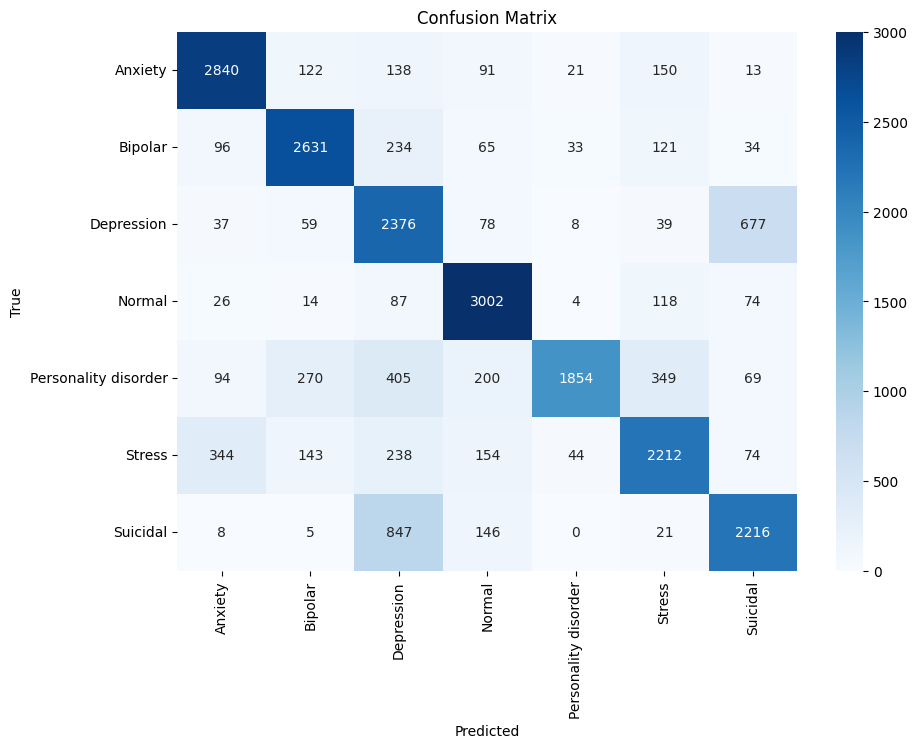

In [24]:
# Predictions
predictions, labels, _ = trainer.predict(test_dataset)

# Convert predictions to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Classification Report
print(classification_report(test_labels, predicted_labels, target_names=label_encoder.classes_))

# Confusion Matrix
cm = confusion_matrix(test_labels, predicted_labels)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [21]:
# Save the trained model and tokenizer
trainer.save_model("/content/saved_mental_status_bert")  # Save the model to the specified directory
tokenizer.save_pretrained("/content/saved_mental_status_bert")  # Save the tokenizer


import pickle

pickle.dump(label_encoder, open('label_encoder.pkl', 'wb'))

In [22]:
from transformers import AutoModelForSequenceClassification, AutoTokenizer

# Load the model and tokenizer from the saved paths
model = AutoModelForSequenceClassification.from_pretrained("saved_mental_status_bert")
tokenizer = AutoTokenizer.from_pretrained("saved_mental_status_bert")

label_encoder = pickle.load(open('label_encoder.pkl', 'rb'))

In [23]:
# Detection System (Example)
def detect_anxiety(text):
    cleaned_text = clean_statement(text)
    inputs = tokenizer(cleaned_text, return_tensors="pt", padding=True, truncation=True, max_length=512)
    outputs = model(**inputs)
    logits = outputs.logits
    predicted_class = torch.argmax(logits, dim=1).item()
    return label_encoder.inverse_transform([predicted_class])[0]

# Test detection system with a mixture of normal, anxiety, bipolar, depression, suicide, etc.
sample_texts = [
    "I feel perfectly fine today, nothing to worry about.",
    "I can't stop thinking about what will happen if things go wrong.",
    "Lately, I've been on a high, feeling like I can do anything!",
    "I'm so sad, I just can't seem to get out of bed anymore.",
    "I'm constantly thinking about how much better everyone else is doing than me.",
    "I don't think I can keep going, everything feels so hopeless.",
    "I had a really good day, spent some time with my friends.",
    "I'm overwhelmed by the idea that I might lose everything.",
    "I feel like nothing matters anymore, I just want to give up.",
    "I'm okay today, but sometimes I get really anxious for no reason."
]

# Assuming the detect_anxiety function is already defined and takes a sentence as input
for text in sample_texts:
    predicted_class = detect_anxiety(text)
    print(f"Sentence: {text}\nPredicted class: {predicted_class}\n")


Sentence: I feel perfectly fine today, nothing to worry about.
Predicted class: Anxiety

Sentence: I can't stop thinking about what will happen if things go wrong.
Predicted class: Normal

Sentence: Lately, I've been on a high, feeling like I can do anything!
Predicted class: Anxiety

Sentence: I'm so sad, I just can't seem to get out of bed anymore.
Predicted class: Normal

Sentence: I'm constantly thinking about how much better everyone else is doing than me.
Predicted class: Normal

Sentence: I don't think I can keep going, everything feels so hopeless.
Predicted class: Suicidal

Sentence: I had a really good day, spent some time with my friends.
Predicted class: Normal

Sentence: I'm overwhelmed by the idea that I might lose everything.
Predicted class: Stress

Sentence: I feel like nothing matters anymore, I just want to give up.
Predicted class: Suicidal

Sentence: I'm okay today, but sometimes I get really anxious for no reason.
Predicted class: Anxiety



In [24]:
import shutil
from google.colab import files

# Step 1: Save the trained model and tokenizer
model_save_path = "/content/Model/saved_mental_status_bert"  # Path to save the trained model
tokenizer_save_path = "/content/Model/saved_mental_status_bert"  # Path to save the tokenizer

# Save the model and tokenizer
trainer.save_model(model_save_path)
tokenizer.save_pretrained(tokenizer_save_path)

# Step 2: Create a zip file containing the saved model and tokenizer using shutil
zip_file_path = "saved_mental_status_bert"  # Path for the zip file without extension

# Create a zip archive of the directories
shutil.make_archive(zip_file_path, 'zip', root_dir='saved_mental_status_bert', base_dir='')

# Step 3: Provide a download link to the zip file
files.download(f"{zip_file_path}.zip")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>